In [1]:
import cv2
import gdown
import os
import random
import shutil
import zipfile

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

random.seed(123)

# Descarga del DataSet

In [2]:
# Se descargan datos originales de entrenamiento y validación de Visdrone

# !gdown --id 1a2oHjcEcwXP8oUF95qiwrqzACb2YlUhn
!gdown --id 1AyXDdDptyxTwksetR5NnKvnI4mY9FqGJ
with zipfile.ZipFile("VisDrone2019-DET-train.zip", 'r') as zip_ref:
    zip_ref.extractall("/content")
os.remove("VisDrone2019-DET-train.zip")

# !gdown --id 1bxK5zgLn0_L8x276eKkuYA_FzwCIjb59
!gdown --id 1GSK33lrOLmhH9YGxbu8EQ6aVnHLE8Bw_
with zipfile.ZipFile("VisDrone2019-DET-val.zip", 'r') as zip_ref:
    zip_ref.extractall("/content")
os.remove("VisDrone2019-DET-val.zip")

/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1AyXDdDptyxTwksetR5NnKvnI4mY9FqGJ
From (redirected): https://drive.google.com/uc?id=1AyXDdDptyxTwksetR5NnKvnI4mY9FqGJ&confirm=t&uuid=9e0ca21e-f515-44c0-bb4d-dec81d42af47
To: /content/VisDrone2019-DET-train.zip
100% 1.55G/1.55G [00:50<00:00, 31.0MB/s]
/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1GSK33lrOLmhH9YGxbu8EQ6aVnHLE8Bw_
From (redirected): https://drive.google.com/uc?id=1GSK33lrOLmhH9YGxbu8EQ6aVnHLE8Bw_&confirm=t&uuid=a24691e1-5c0c-486b-99c9-47fdae3ca6d9
To: /conten

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Conversion de las anotaciones a formato YOLO

In [4]:
def visdrone2yolo(dir):
    from PIL import Image
    from tqdm import tqdm

    def convert_box(size, box):
        # Convert VisDrone box to YOLO xywh box
        dw = 1. / size[0]
        dh = 1. / size[1]
        return (box[0] + box[2] / 2) * dw, (box[1] + box[3] / 2) * dh, box[2] * dw, box[3] * dh

    (dir / 'labels').mkdir(parents=True, exist_ok=True)  # make labels directory
    pbar = tqdm((dir / 'annotations').glob('*.txt'), desc=f'Converting {dir}')
    for f in pbar:
        img_size = Image.open((dir / 'images' / f.name).with_suffix('.jpg')).size
        lines = []
        with open(f, 'r') as file:  # read annotation.txt
            for row in [x.split(',') for x in file.read().strip().splitlines()]:
                if row[4] == '0':  # VisDrone 'ignored regions' class 0
                    continue
                cls = int(row[5]) - 1
                box = convert_box(img_size, tuple(map(int, row[:4])))
                lines.append(f"{cls} {' '.join(f'{x:.6f}' for x in box)}\n")
                with open(str(f).replace(os.sep + 'annotations' + os.sep, os.sep + 'labels' + os.sep), 'w') as fl:
                    fl.writelines(lines)  # write label.txt

In [5]:
from pathlib import Path

train_dir = Path('/content/VisDrone2019-DET-train')
val_dir = Path('/content/VisDrone2019-DET-val')

visdrone2yolo(train_dir)
visdrone2yolo(val_dir)

Converting /content/VisDrone2019-DET-train: 6471it [00:37, 171.76it/s]
Converting /content/VisDrone2019-DET-val: 548it [00:04, 120.38it/s]


In [6]:
%%writefile label_map.txt
0 pedestrian
1 people
2 bicycle
3 car
4 van
5 truck
6 tricycle
7 awning-tricycle
8 bus
9 motor

Writing label_map.txt


In [7]:
# Directorio de imágenes y etiquetas
images_dir_train = 'VisDrone2019-DET-train/images'
labels_dir_train = 'VisDrone2019-DET-train/labels'

images_dir_val = 'VisDrone2019-DET-val/images'
labels_dir_val = 'VisDrone2019-DET-val/labels'

# Analisis de Datos

## Codigo de las Clases

In [8]:
file_path = 'label_map.txt'

# Leer el archivo y crear una lista de diccionarios con label y category
data = []
with open(file_path, 'r') as file:
    for line in file:
        label, category = line.strip().split(' ', 1)
        data.append({'label': int(label), 'category': category})

# Convertir la lista de diccionarios en un DataFrame
df = pd.DataFrame(data)
df

,label,category
0,0,pedestrian
1,1,people
2,2,bicycle
3,3,car
4,4,van
5,5,truck
6,6,tricycle
7,7,awning-tricycle
8,8,bus
9,9,motor


In [9]:
def show_images_with_bboxes(image_files, images_dir, labels_dir, df):
  """
  Muestra imágenes con sus correspondientes bounding boxes.

  Args:
    image_files: Lista de nombres de archivos de imágenes.
    images_dir: Directorio donde se encuentran las imágenes.
    labels_dir: Directorio donde se encuentran las etiquetas.
    df: DataFrame con la información de las etiquetas (label y category).
  """
  for image_file in image_files:
      image_path = os.path.join(images_dir, image_file)
      label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

      # Cargar la imagen
      image = cv2.imread(image_path)
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

      # Cargar las etiquetas
      if os.path.exists(label_path):
          with open(label_path, 'r') as f:
              for line in f:
                  class_id, x_center, y_center, width, height, *_ = line.strip().split()
                  class_id = int(class_id)
                  x_center = float(x_center)
                  y_center = float(y_center)
                  width = float(width)
                  height = float(height)

                  # Calcular las coordenadas de la bounding box
                  image_height, image_width, _ = image.shape
                  x_min = int((x_center - width / 2) * image_width)
                  y_min = int((y_center - height / 2) * image_height)
                  x_max = int((x_center + width / 2) * image_width)
                  y_max = int((y_center + height / 2) * image_height)

                  # Dibujar la bounding box
                  cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == class_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(image, category, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

      # Mostrar la imagen
      plt.figure(figsize=(10, 6))
      plt.imshow(image)
      plt.title(image_file)
      plt.axis('off')
      plt.show()

# Nuevo DataSet

In [10]:
def filter_bboxes_by_area(image_file, images_dir, labels_dir, area_threshold=0.001):
    """
    Filtra las bounding boxes en una imagen basándose en un umbral de área.

    Args:
      image_file: El nombre del archivo de imagen (e.g., 'imagen.jpg').
      images_dir: El directorio donde se encuentra la imagen.
      labels_dir: El directorio donde se encuentra el archivo de etiquetas.
      area_threshold: El umbral de área mínima para las bounding boxes.

    Returns:
      Una lista de líneas (labels) que cumplen con el criterio de área.
    """
    image_path = os.path.join(images_dir, image_file)
    label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

    filtered_lines = []
    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                class_id, x_center, y_center, width, height, *_ = line.strip().split()
                area = float(width) * float(height)
                if area >= area_threshold:
                    filtered_lines.append(line)
    return filtered_lines

# Ejemplo de uso
image_file = '9999937_00000_d_0000219.jpg'
images_dir = 'VisDrone2019-DET-train/images'
labels_dir = 'VisDrone2019-DET-train/labels'
area_threshold = 0.001  # Puedes ajustar este valor

filtered_labels = filter_bboxes_by_area(image_file, images_dir, labels_dir, area_threshold)

print(f"Labels filtrados para {image_file}:")
for line in filtered_labels:
    print(line.strip())

Labels filtrados para 9999937_00000_d_0000219.jpg:
3 0.909447 0.647032 0.047495 0.051020
3 0.892484 0.620130 0.041754 0.043599
3 0.871086 0.590445 0.049061 0.045455
4 0.832724 0.501391 0.058977 0.043599
3 0.853862 0.528293 0.043841 0.023191
5 0.482516 0.720315 0.046451 0.268089
7 0.406054 0.803803 0.019833 0.069573
7 0.325157 0.860390 0.018789 0.060297
5 0.404749 0.544527 0.021399 0.053803


In [11]:
def filter_bboxes_by_class_and_area(image_file, images_dir, labels_dir, df, excluded_classes, area_threshold=0.001):
    """
    Filtra las bounding boxes en una imagen basándose en la clase a la que pertenecen y al area del bounding box.

    Args:
      image_file: El nombre del archivo de imagen (e.g., 'imagen.jpg').
      images_dir: El directorio donde se encuentra la imagen.
      labels_dir: El directorio donde se encuentra el archivo de etiquetas.
      df: DataFrame que contiene las categorías de las clases.
      excluded_classes: Lista con los nombres de las clases a excluir.
      area_threshold: El umbral de área mínima para las bounding boxes.

    Returns:
      Una lista de líneas (labels) que cumplen con el criterio de clase.
    """
    image_path = os.path.join(images_dir, image_file)
    label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))
    filtered_lines = []
    excluded_indexes = []
    new_indexed_lines = []
    new_label_list = []
    new_index = 0

    # Obtenemos los indices correspondientes a las categoria a excluir
    for category in excluded_classes:
        index = df[df['category'] == category].index[0]
        excluded_indexes.append(str(index))

    # Calculamos un nuevo DataFrame con la columna "new_label" con los nuevos indices de las clases no excluidas
    for cat in df["category"]:
        if cat not in excluded_classes:
            new_label_list.append(new_index)
            new_index += 1
        else:
            new_label_list.append("X")

    df_edited = df.copy()
    df_edited["new_label"] = new_label_list

    # Modificamos la data dentro del annotation
    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                # class_id, *_ = line.strip().split()
                class_id, x_center, y_center, width, height, *_ = line.strip().split()
                area = float(width) * float(height)
                if class_id not in excluded_indexes and area >= area_threshold:
                    filtered_lines.append(line)

            for f_line in filtered_lines:
                class_id, x_center, y_center, width, height = f_line.strip().split()
                new_class_id = df_edited.loc[df_edited["label"] == int(class_id), "new_label"].iloc[0]
                new_line = " ".join([str(new_class_id), x_center, y_center, width, height])
                new_indexed_lines.append(new_line)

    return new_indexed_lines

# Ejemplo de uso
image_file = '9999937_00000_d_0000219.jpg'
images_dir = 'VisDrone2019-DET-train/images'
labels_dir = 'VisDrone2019-DET-train/labels'
excluded_classes = ["people", "bicycle", "tricycle", "awning-tricycle"]  # Puedes ajustar estas clases

filtered_labels = filter_bboxes_by_class_and_area(image_file, images_dir, labels_dir, df, excluded_classes)

print(f"Clases filtradas para {image_file}:")
for line in filtered_labels:
    print(line.strip())

Clases filtradas para 9999937_00000_d_0000219.jpg:
1 0.909447 0.647032 0.047495 0.051020
1 0.892484 0.620130 0.041754 0.043599
1 0.871086 0.590445 0.049061 0.045455
2 0.832724 0.501391 0.058977 0.043599
1 0.853862 0.528293 0.043841 0.023191
3 0.482516 0.720315 0.046451 0.268089
3 0.404749 0.544527 0.021399 0.053803


In [12]:
%%writefile new_label_map.txt
0 pedestrian
1 car
2 van
3 truck
4 bus
5 motor

Writing new_label_map.txt


In [13]:
file_path = 'new_label_map.txt'

# Leer el archivo y crear una lista de diccionarios con label y category
data = []
with open(file_path, 'r') as file:
    for line in file:
        label, category = line.strip().split(' ', 1)
        data.append({'label': int(label), 'category': category})

# Convertir la lista de diccionarios en un DataFrame
df_new = pd.DataFrame(data)
df_new

,label,category
0,0,pedestrian
1,1,car
2,2,van
3,3,truck
4,4,bus
5,5,motor


En base a los filtrados anteriores se va a armar un dataset nuevo conteniendo unicamente las imagenes con mayor área en los bounding boxes y excluyendo las clases: "people", "bicycle", "tricycle" y "awning-tricycle"

In [14]:
import os
import shutil
import random
from shutil import copyfile

In [15]:
def filter_and_save_labels(images_dir, labels_dir, output_dir, df, excluded_classes, area_threshold=0.001, num_images=50):
    """
    Selecciona imágenes aleatorias, filtra las bounding boxes por área y guarda las imágenes y
    labels filtrados en un nuevo directorio.

    Args:
      images_dir: Directorio de imágenes.
      labels_dir: Directorio de etiquetas.
      output_dir: Directorio de salida.
      area_threshold: Umbral de área para filtrar bounding boxes.
      num_images: Número de imágenes a seleccionar.
    """
    # Crea el directorio de salida si no existe
    os.makedirs(output_dir, exist_ok=True)
    os.makedirs(os.path.join(output_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(output_dir, 'labels'), exist_ok=True)

    # Selecciona imágenes aleatorias
    image_files = random.sample(os.listdir(images_dir), num_images)

    for image_file in image_files:
        # Copia la imagen al directorio de salida
        image_path = os.path.join(images_dir, image_file)
        output_image_path = os.path.join(output_dir, 'images', image_file)
        copyfile(image_path, output_image_path)

        # Filtra las bounding boxes
        label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))
        filtered_labels = filter_bboxes_by_class_and_area(image_file, images_dir, labels_dir, df, excluded_classes, area_threshold)

        # Guarda las etiquetas filtradas
        if len(filtered_labels) > 0: # no se guardan los .txt sin labels
            output_label_path = os.path.join(output_dir, 'labels', image_file.replace('.jpg', '.txt'))
            with open(output_label_path, 'w') as f:
                for line in filtered_labels:
                    f.write(line + '\n')

In [16]:
# Ejemplo de uso
images_dir = 'VisDrone2019-DET-train/images'
labels_dir = 'VisDrone2019-DET-train/labels'
output_dir = 'VisDrone-ClassAreaFilter-train'
excluded_classes = ["people", "bicycle", "tricycle", "awning-tricycle"]
area_threshold = 0.001
num_images = 500

filter_and_save_labels(images_dir, labels_dir, output_dir, df, excluded_classes, area_threshold, num_images)

In [17]:
def delete_images_without_labels(images_dir, labels_dir):
  """
  Elimina las imágenes que no tienen un archivo de etiquetas correspondiente.

  Args:
    images_dir: Directorio de imágenes.
    labels_dir: Directorio de etiquetas.
  """
  for image_file in os.listdir(images_dir):
    if image_file.endswith('.jpg'):
      label_file = image_file.replace('.jpg', '.txt')
      label_path = os.path.join(labels_dir, label_file)
      if not os.path.exists(label_path):
        image_path = os.path.join(images_dir, image_file)
        os.remove(image_path)
        print(f"Imagen eliminada: {image_file}")

In [18]:
# Ejemplo de uso
delete_images_without_labels(images_dir, labels_dir)

# Visualización de las Clases

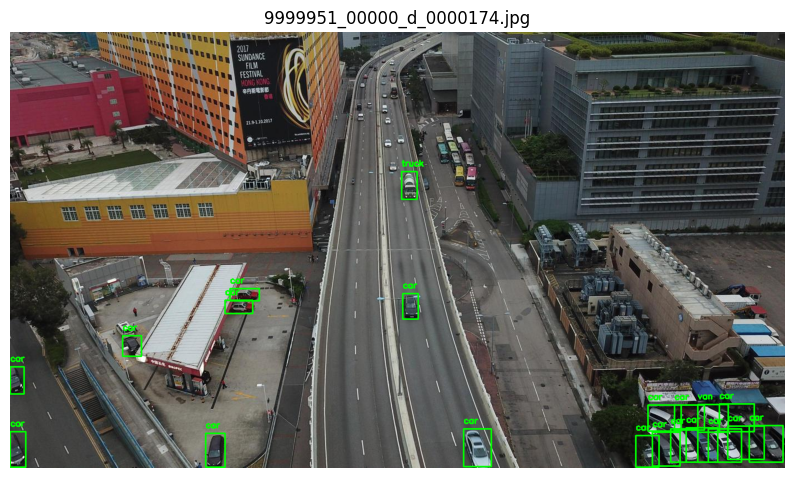

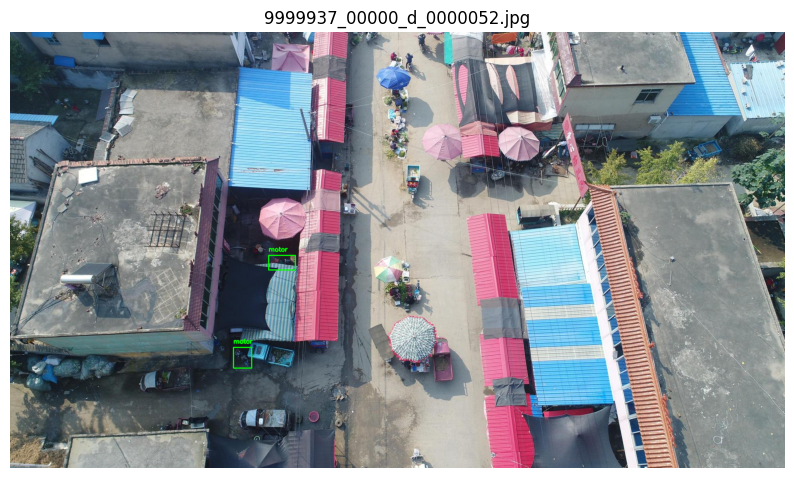

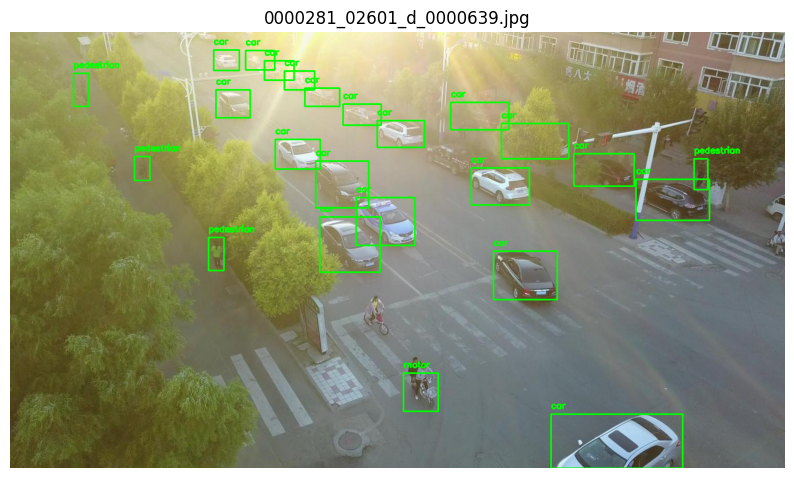

In [19]:
# Número de ejemplos a mostrar
num_examples = 3

# Lista de archivos de imágenes
image_files = [f for f in os.listdir(f'{output_dir}/images') if f.endswith('.jpg')]

# Seleccionar ejemplos aleatorios
random_image_files = random.sample(image_files, num_examples)

show_images_with_bboxes(random_image_files, f'{output_dir}/images', f'{output_dir}/labels', df_new)

Repetimos el proceso de filtrado con el dataset de validación

In [20]:
# Repetimos el proceso para el dataset de validacion

images_dir = 'VisDrone2019-DET-val/images'
labels_dir = 'VisDrone2019-DET-val/labels'
output_dir = 'VisDrone-ClassAreaFilter-val'
excluded_classes = ["people", "bicycle", "tricycle", "awning-tricycle"]
area_threshold = 0.001
num_images = 500

filter_and_save_labels(images_dir, labels_dir, output_dir, df, excluded_classes, area_threshold, num_images)

In [21]:
delete_images_without_labels(images_dir, labels_dir)

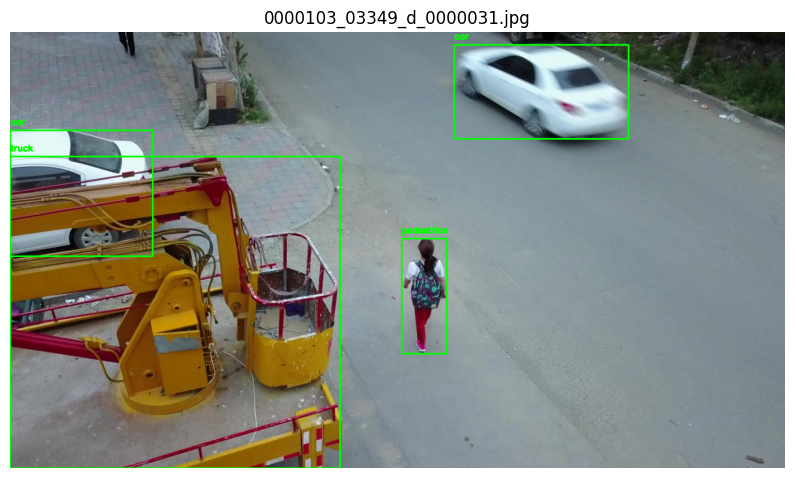

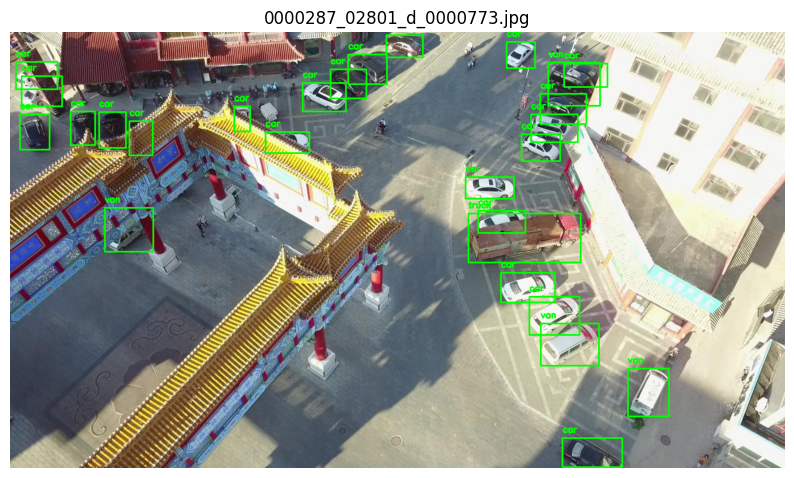

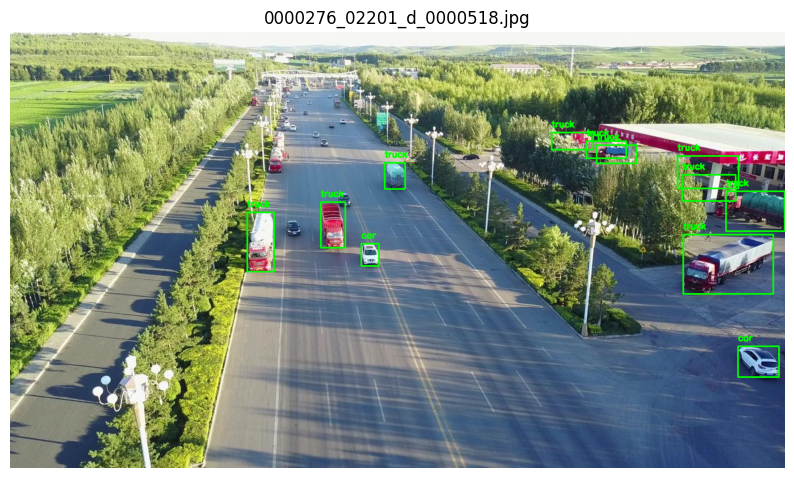

In [22]:
# Número de ejemplos a mostrar
num_examples = 3

# Lista de archivos de imágenes
image_files = [f for f in os.listdir(f'{output_dir}/images') if f.endswith('.jpg')]

# Seleccionar ejemplos aleatorios
random_image_files = random.sample(image_files, num_examples)

show_images_with_bboxes(random_image_files, f'{output_dir}/images', f'{output_dir}/labels', df_new)

# Nuevo Balance de Clases

Cantidad de imagenes: 476


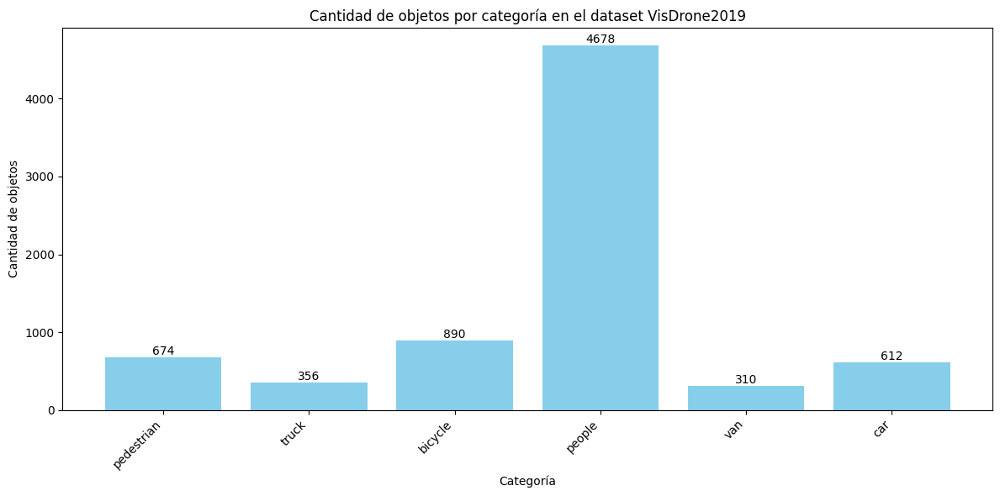

In [23]:
category_counts = {}
images = 0
labels_dir_train = 'VisDrone-ClassAreaFilter-train/labels' #'VisDrone2019-DET-train/labels'

# Iterar sobre todos los archivos .txt en la carpeta
for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        # Abrir el archivo y contar cuántos objetos hay por categoría
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            images += 1
            for line in file:
                category = int(line.split()[0])  # El label de la categoría es la primera columna en YOLO
                category_counts[category] = category_counts.get(category, 0) + 1

# Convertir los datos a un DataFrame para facilitar el manejo
df_counts = pd.DataFrame(list(category_counts.items()), columns=['label', 'count'])
print("Cantidad de imagenes:",images)

df_merged = pd.merge(df_counts, df, on='label')

plt.figure(figsize=(12, 6))
bars = plt.bar(df_merged['category'], df_merged['count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de objetos')
plt.title('Cantidad de objetos por categoría en el dataset VisDrone2019')
plt.xticks(rotation=45, ha='right')

for bar in bars:
  yval = bar.get_height()
  plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center')

plt.tight_layout()
plt.show()

# Entrenamiento del Modelo

In [24]:
%%writefile data.yaml
train: ../../VisDrone-ClassAreaFilter-train/images
val: ../../VisDrone-ClassAreaFilter-val/images

nc: 6
names: ["pedestrian", "car", "van", "truck", "bus", "motor"]

Writing data.yaml


In [25]:
# Se carga Tensorboard para el entrenamiento

%load_ext tensorboard
%tensorboard --logdir runs/detect/train

<IPython.core.display.Javascript object>

In [26]:
!pip install ultralytics
from ultralytics import YOLO

# Cargar el modelo YOLOv8
model = YOLO('yolov8s.pt')

# Entrenar el modelo congelando las primeras 10 capas (hasta el bloque SPPF)
results = model.train(
    data='data.yaml',
    imgsz=640,
    batch=16,
    epochs=50,
    freeze=10,  # Congela las primeras 10 capas (backbone completo)
    auto_augment=False, # Desactivar auto augmentation
    mosaic=0,          # Desactivar mosaic
    hsv_h=0,           # No variación en matiz
    hsv_s=0,           # No variación en saturación
    hsv_v=0,           # No variación en brillo
    degrees=0,         # Sin rotación
    translate=0,       # Sin traslación
    scale=0,           # Sin escalado
    shear=0,           # Sin corte
    flipud=0,          # No flip vertical
    fliplr=0,          # No flip horizontal
    copy_paste=0       # Desactivar Copy-Paste
)

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 881.4/881.4 kB 57.0 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 21.5M/21.5M [00:00<00:00, 277MB/s]


Ultralytics 8.3.3 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=10, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=No

100%|██████████| 755k/755k [00:00<00:00, 109MB/s]


Overriding model.yaml nc=80 with nc=6

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 337MB/s]


AMP: checks passed ✅


train: Scanning /content/VisDrone-ClassAreaFilter-train/labels... 476 images, 24 backgrounds, 0 corrupt: 100%|██████████| 500/500 [00:00<00:00, 1830.95it/s]

train: New cache created: /content/VisDrone-ClassAreaFilter-train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.17 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/VisDrone-ClassAreaFilter-val/labels... 498 images, 2 backgrounds, 0 corrupt: 100%|██████████| 500/500 [00:00<00:00, 591.63it/s]


val: New cache created: /content/VisDrone-ClassAreaFilter-val/labels.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 63 weight(decay=0.0), 70 weight(decay=0.0005), 69 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.46G      1.409      3.675       1.06         56        640: 100%|██████████| 32/32 [00:12<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.25it/s]

                   all        500      10177     0.0474      0.153     0.0567     0.0315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50       2.3G      1.331      2.226      1.013         64        640: 100%|██████████| 32/32 [00:08<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.28it/s]

                   all        500      10177     0.0567      0.279     0.0962     0.0628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.35G      1.225      1.773     0.9745         51        640: 100%|██████████| 32/32 [00:07<00:00,  4.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.01it/s]


                   all        500      10177     0.0471      0.515      0.149     0.0912

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.45G      1.139      1.558      0.949         66        640: 100%|██████████| 32/32 [00:06<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.46it/s]


                   all        500      10177      0.462      0.155      0.235      0.141

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.27G      1.068      1.455     0.9229         67        640: 100%|██████████| 32/32 [00:08<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:05<00:00,  3.19it/s]

                   all        500      10177      0.381       0.27      0.269      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.28G      1.012      1.325     0.9066         37        640: 100%|██████████| 32/32 [00:10<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.23it/s]

                   all        500      10177      0.369      0.339      0.298      0.175



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.31G     0.9557      1.193     0.8939        120        640: 100%|██████████| 32/32 [00:09<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.61it/s]


                   all        500      10177      0.369      0.347      0.301      0.179

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.35G     0.9072      1.081     0.8803         76        640: 100%|██████████| 32/32 [00:07<00:00,  4.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.01it/s]

                   all        500      10177      0.365       0.36      0.314      0.188



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.38G     0.8456     0.9949     0.8655         33        640: 100%|██████████| 32/32 [00:06<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.46it/s]


                   all        500      10177      0.382      0.362      0.314      0.184

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.26G     0.8097     0.9245     0.8583         48        640: 100%|██████████| 32/32 [00:07<00:00,  4.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.25it/s]


                   all        500      10177      0.378      0.349        0.3      0.177

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.32G     0.7677     0.8404     0.8476         82        640: 100%|██████████| 32/32 [00:10<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.42it/s]


                   all        500      10177      0.363      0.369       0.32       0.19

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.34G     0.7342     0.7942     0.8406        102        640: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:05<00:00,  2.67it/s]


                   all        500      10177      0.379      0.363       0.32      0.191

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.31G     0.7069     0.7503     0.8345         70        640: 100%|██████████| 32/32 [00:07<00:00,  4.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.94it/s]

                   all        500      10177      0.356      0.373      0.315      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.25G     0.6626     0.7086      0.828        145        640: 100%|██████████| 32/32 [00:06<00:00,  4.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.54it/s]


                   all        500      10177      0.364      0.354      0.306       0.18

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.28G     0.6299     0.6583     0.8215         66        640: 100%|██████████| 32/32 [00:08<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.43it/s]


                   all        500      10177      0.386      0.357      0.317      0.189

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.39G     0.6311     0.6516     0.8223         50        640: 100%|██████████| 32/32 [00:10<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.41it/s]

                   all        500      10177       0.38      0.367      0.316      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.28G     0.6075     0.6086     0.8171         65        640: 100%|██████████| 32/32 [00:07<00:00,  4.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.06it/s]


                   all        500      10177      0.433       0.34      0.323      0.191

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.35G     0.5924     0.5868     0.8133         54        640: 100%|██████████| 32/32 [00:06<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.32it/s]


                   all        500      10177      0.393       0.38      0.323      0.188

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50       2.4G     0.5517     0.5457     0.8084         54        640: 100%|██████████| 32/32 [00:08<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.48it/s]


                   all        500      10177      0.372      0.379      0.321      0.188

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.31G     0.5278     0.5306     0.8036         45        640: 100%|██████████| 32/32 [00:09<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.45it/s]

                   all        500      10177      0.407      0.364      0.323      0.188



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.27G     0.5324     0.5386     0.8057         58        640: 100%|██████████| 32/32 [00:09<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.49it/s]

                   all        500      10177      0.373      0.376      0.323      0.189



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.39G     0.5057     0.5408     0.8004         29        640: 100%|██████████| 32/32 [00:07<00:00,  4.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.96it/s]

                   all        500      10177      0.382      0.361      0.322      0.187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.34G      0.501     0.5089     0.8026         74        640: 100%|██████████| 32/32 [00:07<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.58it/s]


                   all        500      10177      0.419       0.34      0.322      0.188

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.32G     0.4822     0.4916     0.7986         47        640: 100%|██████████| 32/32 [00:08<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.48it/s]


                   all        500      10177      0.366      0.369       0.32      0.185

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50       2.3G     0.4548     0.4684     0.7937         48        640: 100%|██████████| 32/32 [00:10<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.40it/s]


                   all        500      10177      0.383      0.359      0.318      0.185

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50       2.3G     0.4568     0.4747     0.7929         18        640: 100%|██████████| 32/32 [00:08<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.05it/s]


                   all        500      10177      0.383      0.373      0.324      0.191

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.34G     0.4422     0.4584     0.7949         47        640: 100%|██████████| 32/32 [00:06<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.38it/s]


                   all        500      10177      0.379      0.383      0.327      0.192

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.34G     0.4262      0.435     0.7915         42        640: 100%|██████████| 32/32 [00:08<00:00,  3.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.50it/s]


                   all        500      10177      0.385      0.374      0.325      0.193

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.28G      0.434     0.4527     0.7942         85        640: 100%|██████████| 32/32 [00:10<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.47it/s]


                   all        500      10177      0.367      0.384      0.324       0.19

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.35G     0.4125     0.4256     0.7895         55        640: 100%|██████████| 32/32 [00:08<00:00,  3.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.37it/s]


                   all        500      10177      0.394      0.361      0.324       0.19

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50       2.3G     0.4068     0.4219     0.7902         97        640: 100%|██████████| 32/32 [00:06<00:00,  4.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.10it/s]


                   all        500      10177        0.4      0.366      0.321      0.188

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.33G     0.3932     0.4037     0.7875        100        640: 100%|██████████| 32/32 [00:06<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:05<00:00,  3.08it/s]

                   all        500      10177      0.411      0.362      0.327      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.26G     0.3918     0.4033     0.7883         63        640: 100%|██████████| 32/32 [00:09<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.49it/s]


                   all        500      10177      0.392      0.371      0.326      0.195

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.29G     0.3782     0.3935     0.7879         22        640: 100%|██████████| 32/32 [00:10<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:05<00:00,  3.01it/s]

                   all        500      10177      0.392      0.361      0.325      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.29G     0.3829     0.3984     0.7871         40        640: 100%|██████████| 32/32 [00:07<00:00,  4.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.99it/s]

                   all        500      10177       0.39      0.373      0.332      0.196



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.37G     0.3671     0.3782     0.7845         66        640: 100%|██████████| 32/32 [00:06<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.53it/s]

                   all        500      10177      0.393      0.368      0.331      0.196



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.34G     0.3657     0.3806     0.7844         34        640: 100%|██████████| 32/32 [00:08<00:00,  3.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.41it/s]

                   all        500      10177      0.399      0.369       0.33      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.33G     0.3626     0.3746     0.7848         86        640: 100%|██████████| 32/32 [00:10<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.46it/s]

                   all        500      10177      0.394       0.36      0.326      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.27G     0.3463     0.3665      0.783         98        640: 100%|██████████| 32/32 [00:08<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.23it/s]

                   all        500      10177      0.395      0.359      0.324      0.192



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50       2.3G     0.3342      0.355      0.781         84        640: 100%|██████████| 32/32 [00:06<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.33it/s]

                   all        500      10177      0.371      0.388      0.328      0.194


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.38G     0.3251     0.3509     0.7806         62        640: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.45it/s]


                   all        500      10177      0.358       0.38      0.323      0.192

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.26G     0.3218     0.3438     0.7813         62        640: 100%|██████████| 32/32 [00:08<00:00,  3.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.45it/s]


                   all        500      10177      0.377      0.373      0.325      0.193

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.39G     0.3195      0.345       0.78         54        640: 100%|██████████| 32/32 [00:10<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.36it/s]


                   all        500      10177      0.382      0.372      0.325      0.194

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.18G     0.3223     0.3423     0.7822         67        640: 100%|██████████| 32/32 [00:08<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.44it/s]


                   all        500      10177      0.372      0.377      0.326      0.193

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.26G     0.3073     0.3333     0.7803         44        640: 100%|██████████| 32/32 [00:07<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.04it/s]

                   all        500      10177      0.379       0.38      0.327      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.26G     0.2971     0.3236     0.7785         38        640: 100%|██████████| 32/32 [00:06<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:05<00:00,  2.81it/s]

                   all        500      10177      0.382      0.379      0.327      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.43G     0.3014     0.3263     0.7777         39        640: 100%|██████████| 32/32 [00:09<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.50it/s]


                   all        500      10177      0.382      0.378      0.326      0.194

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.42G     0.3032     0.3315     0.7802         75        640: 100%|██████████| 32/32 [00:09<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:05<00:00,  2.82it/s]


                   all        500      10177      0.387      0.369      0.324      0.193

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.35G     0.2933     0.3255      0.778         45        640: 100%|██████████| 32/32 [00:07<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.04it/s]


                   all        500      10177      0.385      0.381      0.327      0.194

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.29G     0.2854     0.3158      0.778         66        640: 100%|██████████| 32/32 [00:06<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.46it/s]

                   all        500      10177      0.382      0.376      0.327      0.194



50 epochs completed in 0.217 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 19.9MB
Optimizer stripped from runs/detect/train/weights/best.pt, 19.9MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.3 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 186 layers, 9,829,986 parameters, 0 gradients, 23.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:09<00:00,  1.61it/s]


                   all        500      10177      0.393      0.368      0.331      0.196
            pedestrian        251       1127      0.424      0.504      0.439      0.206
                   car        460       6581      0.668      0.727       0.73      0.504
                   van        342        981      0.219      0.276       0.17      0.103
                 truck        201        433      0.224      0.125        0.1     0.0611
                   bus         81        134      0.447      0.358       0.34      0.227
                 motor        295        921      0.377      0.216      0.205     0.0766
Speed: 0.2ms preprocess, 2.7ms inference, 0.0ms loss, 2.1ms postprocess per image
Results saved to runs/detect/train


In [27]:
def predict_and_show_images_comparison(image_files, model, images_dir, labels_dir, df, confidence_threshold=0.5):
  """
  Realiza predicciones con el modelo YOLO en un conjunto de imágenes y muestra las imágenes con las bounding boxes, comparando
  la predicción con las etiquetas reales.

  Args:
    image_files: Una lista de nombres de archivos de imágenes.
    model: El modelo YOLO a utilizar para las predicciones.
    images_dir: El directorio donde se encuentran las imágenes.
    labels_dir: Directorio donde se encuentran las etiquetas.
    df: DataFrame con la información de las etiquetas (label y category).
    confidence_threshold: El umbral de confianza para las predicciones.
  """
  for image_file in image_files:
      image_path = os.path.join(images_dir, image_file)
      label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

      # Realizar la predicción
      results = model(image_path)

      # Obtener la primera predicción (si hay más de una)
      predicted_image = cv2.imread(image_path)
      predicted_image = cv2.cvtColor(predicted_image, cv2.COLOR_BGR2RGB)
      if results and results[0].boxes:
          boxes = results[0].boxes.xywh.cpu().numpy()  # Coordenadas de las bounding boxes
          confidence = results[0].boxes.conf.cpu().numpy()
          class_ids = results[0].boxes.cls.cpu().numpy().astype(int)

          for box, conf, cls_id in zip(boxes, confidence, class_ids):
              if conf >= confidence_threshold:
                  x_center, y_center, width, height = box
                  x_min = int(x_center - width / 2)
                  y_min = int(y_center - height / 2)
                  x_max = int(x_center + width / 2)
                  y_max = int(y_center + height / 2)

                  # Dibujar la bounding box
                  cv2.rectangle(predicted_image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == cls_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(predicted_image, f"{category}: {conf:.2f}", (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)


      # Cargar la imagen real con las bounding boxes reales
      real_image = cv2.imread(image_path)
      real_image = cv2.cvtColor(real_image, cv2.COLOR_BGR2RGB)

      # Cargar las etiquetas
      if os.path.exists(label_path):
          with open(label_path, 'r') as f:
              for line in f:
                  class_id, x_center, y_center, width, height, *_ = line.strip().split()
                  class_id = int(class_id)
                  x_center = float(x_center)
                  y_center = float(y_center)
                  width = float(width)
                  height = float(height)

                  # Calcular las coordenadas de la bounding box
                  image_height, image_width, _ = real_image.shape
                  x_min = int((x_center - width / 2) * image_width)
                  y_min = int((y_center - height / 2) * image_height)
                  x_max = int((x_center + width / 2) * image_width)
                  y_max = int((y_center + height / 2) * image_height)

                  # Dibujar la bounding box
                  cv2.rectangle(real_image, (x_min, y_min), (x_max, y_max), (0, 0, 255), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == class_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(real_image, category, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)


      # Combinar las imágenes lado a lado
      combined_image = np.concatenate((predicted_image, real_image), axis=1)

      # Mostrar la imagen combinada
      plt.figure(figsize=(15, 6))
      plt.imshow(combined_image)
      plt.title(f"Predicción vs. Real - {image_file}")
      plt.axis('off')
      plt.show()

In [28]:
# Directorio de imágenes y etiquetas
images_dir_train = 'VisDrone-ClassAreaFilter-train/images'
labels_dir_train = 'VisDrone-ClassAreaFilter-train/labels'

images_dir_val = 'VisDrone-ClassAreaFilter-val/images'
labels_dir_val = 'VisDrone-ClassAreaFilter-val/labels'


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000346_03921_d_0000366.jpg: 384x640 21 cars, 3 vans, 1 motor, 62.3ms
Speed: 3.1ms preprocess, 62.3ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


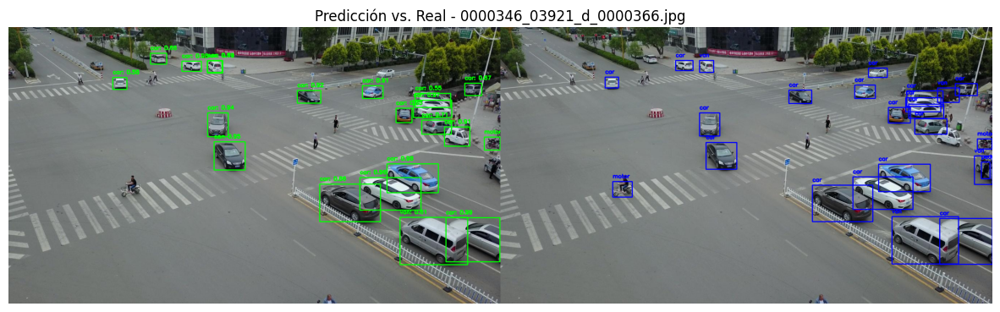


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000345_07057_d_0000345.jpg: 384x640 3 pedestrians, 12 cars, 3 motors, 15.3ms
Speed: 3.1ms preprocess, 15.3ms inference, 6.0ms postprocess per image at shape (1, 3, 384, 640)


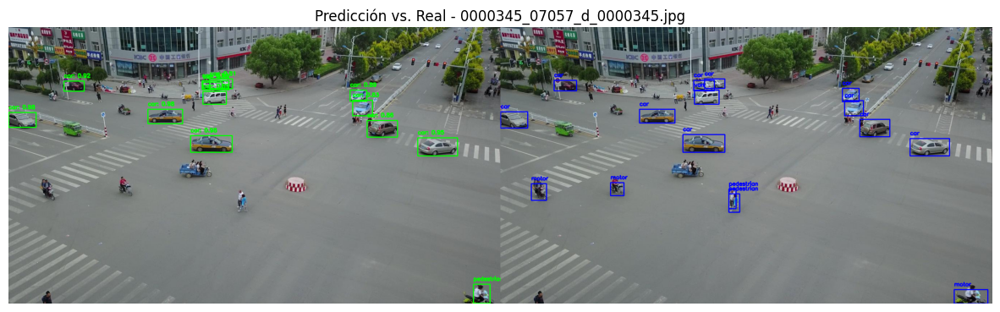


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000289_04601_d_0000834.jpg: 384x640 12 pedestrians, 12 cars, 2 vans, 1 bus, 6 motors, 14.4ms
Speed: 6.0ms preprocess, 14.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


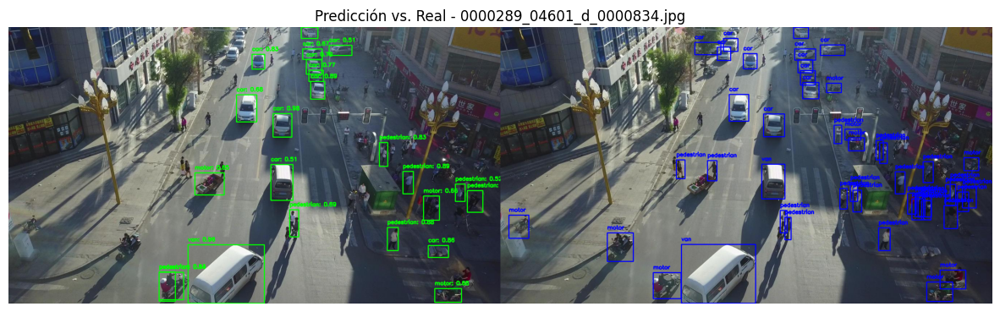


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000271_03001_d_0000387.jpg: 384x640 2 pedestrians, 7 cars, 1 van, 1 truck, 19.9ms
Speed: 5.2ms preprocess, 19.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


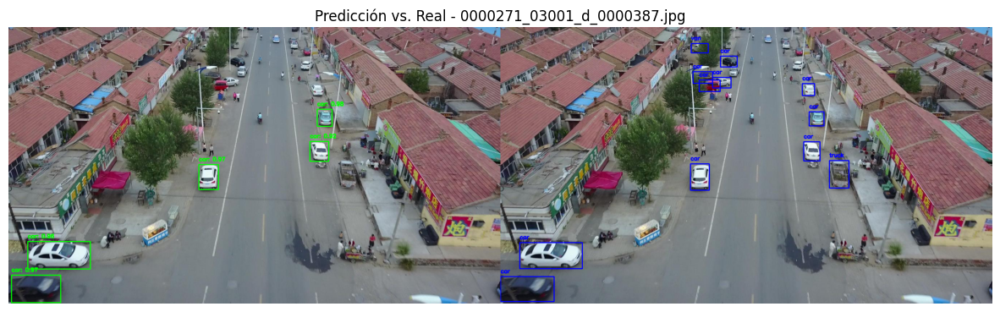


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000289_03001_d_0000826.jpg: 384x640 19 cars, 5 vans, 1 bus, 1 motor, 12.2ms
Speed: 3.1ms preprocess, 12.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


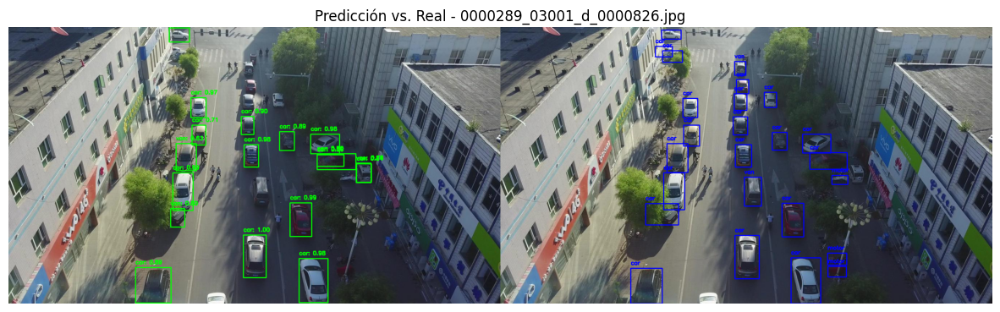


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000244_04400_d_0000010.jpg: 384x640 19 cars, 4 vans, 1 motor, 10.5ms
Speed: 2.9ms preprocess, 10.5ms inference, 5.3ms postprocess per image at shape (1, 3, 384, 640)


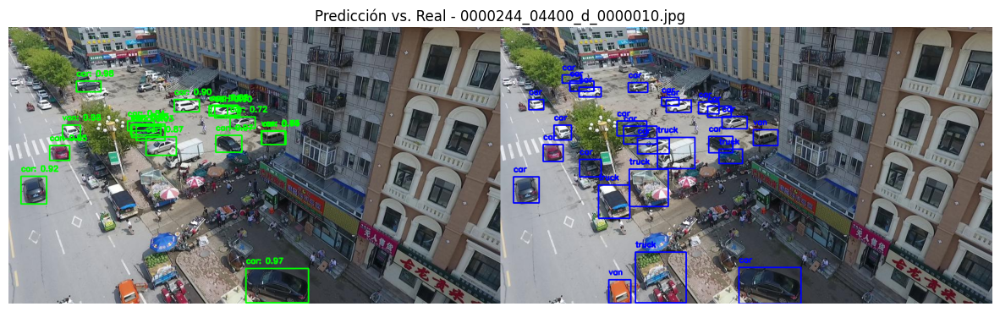


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000335_06665_d_0000077.jpg: 384x640 2 pedestrians, 10 cars, 2 vans, 1 motor, 11.3ms
Speed: 4.1ms preprocess, 11.3ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


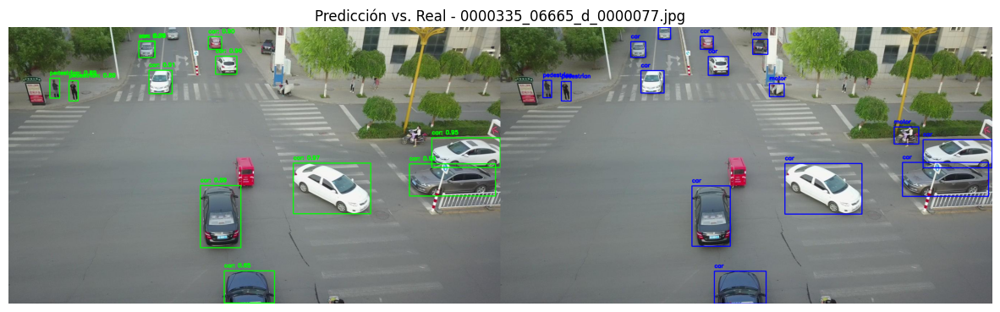


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000117_03096_d_0000091.jpg: 384x640 6 pedestrians, 11 cars, 5 vans, 1 truck, 1 motor, 13.2ms
Speed: 6.2ms preprocess, 13.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


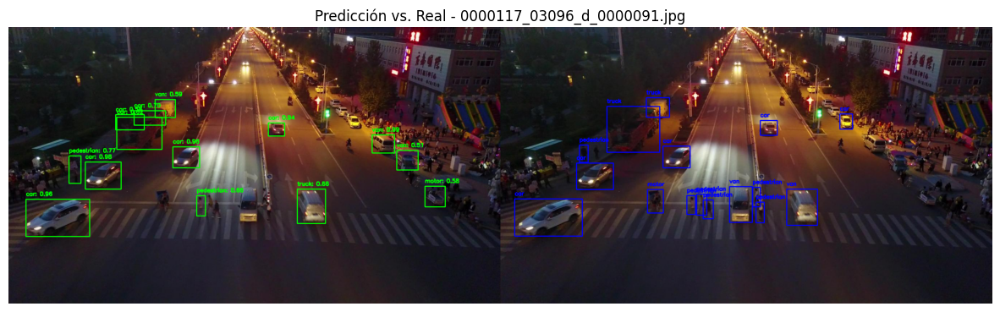


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000213_04998_d_0000245.jpg: 384x640 27 cars, 3 vans, 13.4ms
Speed: 5.8ms preprocess, 13.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


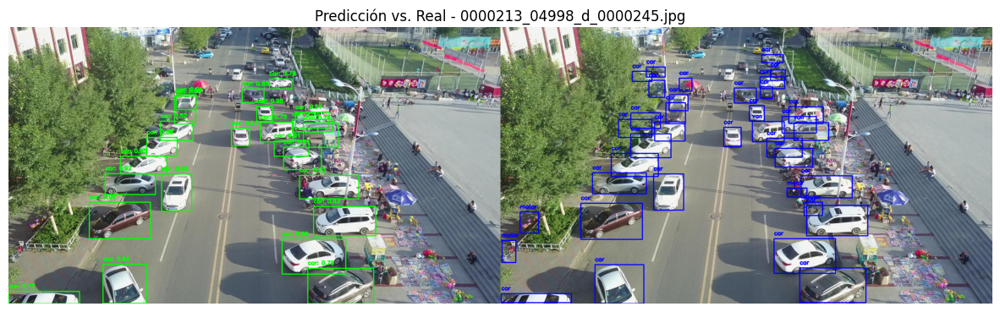


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000359_03333_d_0000711.jpg: 384x640 2 pedestrians, 2 cars, 1 van, 1 motor, 10.7ms
Speed: 3.2ms preprocess, 10.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


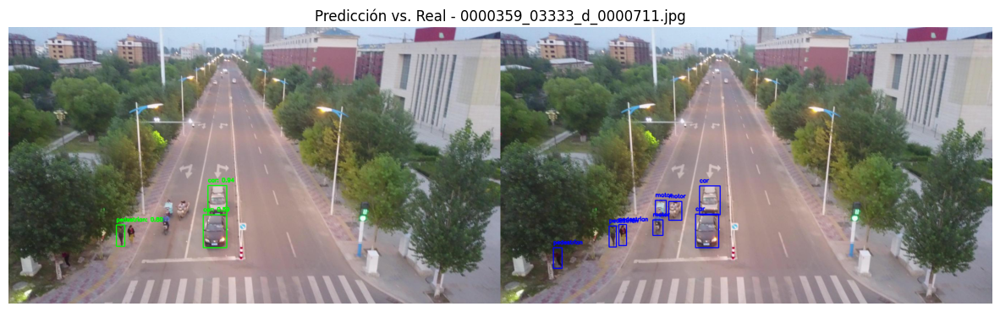

In [29]:
# Ejemplos en validación
image_files_to_predict = random.sample(os.listdir(images_dir_val), 10)

# Realizar predicciones y mostrar las imágenes con las bounding boxes
predict_and_show_images_comparison(image_files_to_predict, model, images_dir_val, labels_dir_val, df_new)

In [30]:
from google.colab import files

# Save the model to a file (e.g., 'best.pt')
model.save('model.pt')

# Download the saved model to your local machine
files.download('model.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>